<a href="https://colab.research.google.com/github/wzinkann/Twitter_Anaylsis/blob/main/Twitter_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Twitter Analysis
## Will Zinkann
### 04/09/2021

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import csv
from networkx.algorithms import community

In [ ]:
twitter_df = pd.read_csv('https://drive.google.com/uc?export=download&id=1ReTRAhHv_IsWv_gE1sm99lfhu-VkEaYU')
twitter_df.head()

,Date,Screen Name,Full Name,Tweet Text,Tweet ID,App,Followers,Follows,Retweets,Favorites,Verfied,User Since,Location,Bio,Profile Image
0,3/15/16,@_Lightscap3s_,Otis,"RT @NatureBridge: ""NatureBridge is Highlight o...",7.100000e+17,RoundTeam,2644,590.0,1,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
1,3/21/16,@_Lightscap3s_,Otis,RT @NatureBridge: By 2050 we want more fish th...,7.120000e+17,RoundTeam,2641,587.0,2,0,No,6/8/09,"Carmel, IN","Artist @ Framed Lightscap3s LLC | Landscape, M...",View
2,4/6/16,@_Lindsay_Conway,Lindsay,RT @savageducates: Greenest School on #Earth s...,7.180000e+17,Twitter for iPhone,164,318.0,2,0,No,6/7/14,"Bratislava, Slovakia",International education. SEN interests. Adopti...,View
3,3/23/16,@_mcisneros19,Mirella Cisneros,A1: For math children could measure trunks to ...,7.130000e+17,TweetDeck,8,44.0,0,0,No,2/4/16,NaN,NaN,View
4,3/23/16,@_mcisneros19,Mirella Cisneros,A2: Going outside & letting children find the ...,7.130000e+17,TweetDeck,8,44.0,0,0,No,2/4/16,NaN,NaN,View


### 2

#### a) What are your observations about how often the various apps (e.g., TweetDeck, Twitter for iPhone) are used to tweet? Show a visualization. (Just show the top few apps.)

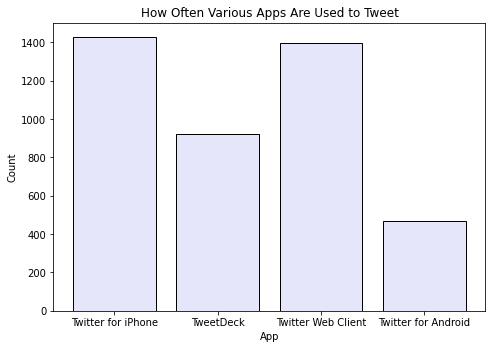

In [ ]:
app = twitter_df['App']
tFiP = twitter_df['App'] == 'Twitter for iPhone'
tD = twitter_df['App'] == 'TweetDeck'
tWC = twitter_df['App'] == 'Twitter Web Client'
tFA = twitter_df['App'] == 'Twitter for Android'

# Fig
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
Apps = ['Twitter for iPhone', 'TweetDeck', 'Twitter Web Client', 'Twitter for Android']
Count = [app[tFiP].count(),app[tD].count(),app[tWC].count(),app[tFA].count()]
ax.bar(Apps,Count,color='lavender',ec='k')
plt.xlabel('App')
plt.ylabel('Count')
plt.title('How Often Various Apps Are Used to Tweet')
plt.show()

The most popular are Twitter for iPhone and Twitter Web Client, this makes sense to me as these are the only two apps i have used twitter on.

#### b) What are your observations about how many original tweets there are compared to retweets (original contributions vs. amplification of others)? (Note that retweets start with the text RT and a username that starts with @.) Show a visualization.

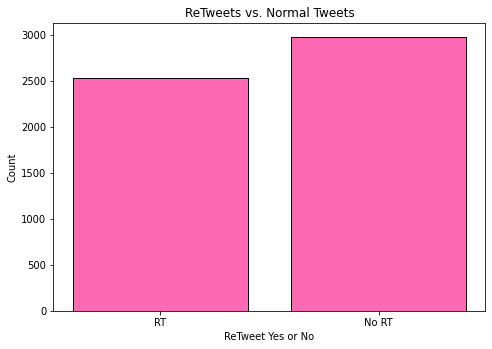

In [ ]:
RT_True = twitter_df.loc[twitter_df['Tweet Text'].str.startswith("RT @")]
RT_False = twitter_df.loc[~twitter_df['Tweet Text'].str.startswith("RT @")]
# print('RT: ',RT_True['Tweet Text'].count())
# print('No RT: ',RT_False['Tweet Text'].count())

# Fig
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
x = ['RT', 'No RT']
y = [RT_True['Tweet Text'].count(),RT_False['Tweet Text'].count()]
ax.bar(x,y,color='hotpink',ec='k')
plt.xlabel('ReTweet Yes or No')
plt.ylabel('Count')
plt.title('ReTweets vs. Normal Tweets')
plt.show()

The majority of tweets from the sample are ReTweets, this is suprising to me as this means that the majority of tweets are not original, just amplifications of other tweets.

#### c) Compare how many tweets are replies vs. non-replies (showing interaction among people). Note that replies start with @username to show they are a reply to a specific user. Show a visualization.

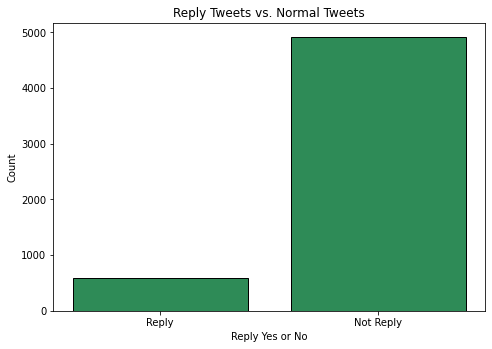

In [ ]:
reply_True = twitter_df.loc[twitter_df['Tweet Text'].str.startswith("@")]
reply_False = twitter_df.loc[~twitter_df['Tweet Text'].str.startswith("@")]
# print('reply true: ',reply_True['Tweet Text'].count())
# print('reply false: ',reply_False['Tweet Text'].count())

# fig
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
x = ['Reply', 'Not Reply']
y = [reply_True['Tweet Text'].count(),reply_False['Tweet Text'].count()]
ax.bar(x,y,color='seagreen',ec='k')
plt.xlabel('Reply Yes or No')
plt.ylabel('Count')
plt.title('Reply Tweets vs. Normal Tweets')
plt.show()

Reply tweets only make up a very small margin of the sample tweets.

#### d) What are your observations about the distribution of followers counts (i.e., how many other users were following the poster of a given tweet)? Show a visualization. Note that the distribution of a single numeric column is generally best shown with a histogram.

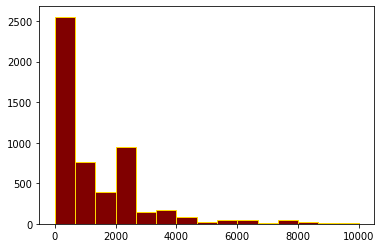

In [ ]:
fig = plt.figure()
plt.hist(twitter_df['Followers'], bins=15, range=[0, 10000], color = "maroon", ec="gold")
plt.show()

The few accounts with many followers ruined this distribution, so to fix that I added a x-axis range limiting the numbers to 10,000. The distribution is still very right skewed since the majority of accounts have a small amount of followers.

#### e) What are your observations about the distribution of follows counts (i.e., how many other accounts are followed by the poster of a given tweet) and how does it compare to the distribution of followers counts? Show a visualization. 

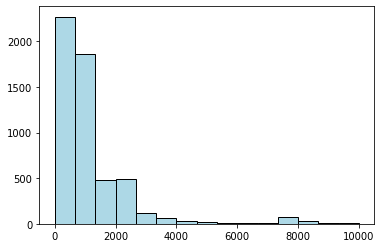

In [ ]:
fig = plt.figure()
plt.hist(twitter_df['Follows'], bins=15, range=[0, 10000], color = "lightblue", ec="k")
plt.show()

Although this is still right skewed, there are more values in the 500-2000 range than accounts 'followers' counts. This means that people are most likely going to follow more accounts than accounts who follow them.

#### e) Where are people tweeting? We don’t have complete or easily parsed location data unfortunately. For a quick analysis, we can use the Location column, which is populated based on whatever a given user added in their profile on Twitter, although this may be blank or contain unhelpful information. Make two graphs showing the top 25 locations, one based on number of tweets sent from that location, and one based on number of users from that location.

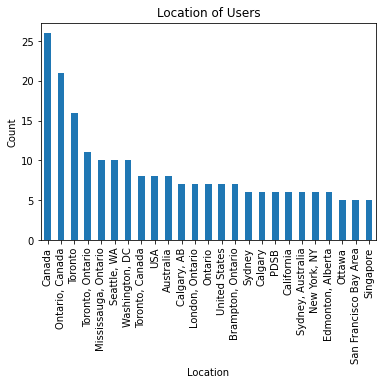

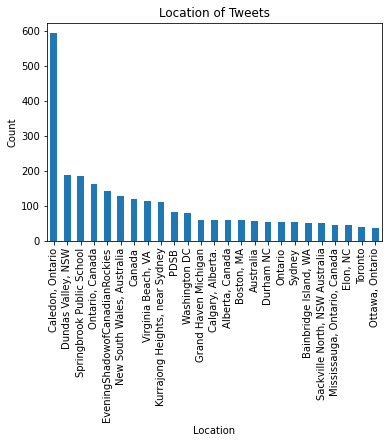

In [ ]:
unique_df = twitter_df.drop_duplicates(subset=['Screen Name'])
users_location_list = unique_df['Location'].value_counts()[:25]
tweets_location_list = twitter_df['Location'].value_counts()[:25]
# print(users_location_list)
# print(tweets_location_list)

# Users
plotdata = users_location_list
plotdata.plot(kind="bar")
plt.xlabel('Location')
plt.ylabel('Count')
plt.title('Location of Users')
plt.show()


# Tweets
plotdata2 = tweets_location_list
plotdata2.plot(kind="bar")
plt.xlabel('Location')
plt.ylabel('Count')
plt.title('Location of Tweets')
plt.show()


#### g) When are people tweeting? Discuss your observations of when people tweet by analyzing the date column. (You may need to Google a bit for help with working with dates.)

0


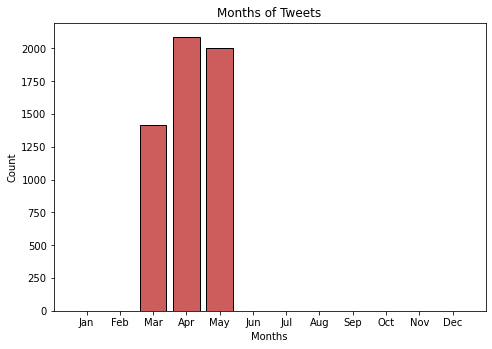

In [ ]:
jan = twitter_df.loc[twitter_df['Date'].str.startswith("1")]['Date'].count()
feb = twitter_df.loc[twitter_df['Date'].str.startswith("2")]['Date'].count()
mar = twitter_df.loc[twitter_df['Date'].str.startswith("3")]['Date'].count()
apr = twitter_df.loc[twitter_df['Date'].str.startswith("4")]['Date'].count()
may = twitter_df.loc[twitter_df['Date'].str.startswith("5")]['Date'].count()
jun = twitter_df.loc[twitter_df['Date'].str.startswith("6")]['Date'].count()
jul = twitter_df.loc[twitter_df['Date'].str.startswith("7")]['Date'].count()
aug = twitter_df.loc[twitter_df['Date'].str.startswith("8")]['Date'].count()
sep = twitter_df.loc[twitter_df['Date'].str.startswith("9")]['Date'].count()
oct = twitter_df.loc[twitter_df['Date'].str.startswith("10")]['Date'].count()
nov = twitter_df.loc[twitter_df['Date'].str.startswith("11")]['Date'].count()
dec = twitter_df.loc[twitter_df['Date'].str.startswith("12")]['Date'].count()

print(jan)
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
x1 = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']
y1 = [jan,feb,mar,apr,may,jun,jul,aug,sep,oct,nov,dec]
ax.bar(x1,y1,color='indianred',ec='k')
plt.xlabel('Months')
plt.ylabel('Count')
plt.title('Months of Tweets')
plt.show()

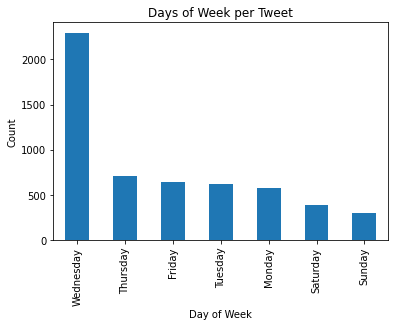

In [ ]:
twitter_df['Date'] = pd.to_datetime(twitter_df['Date'])

dayOfWeek = twitter_df['Date'].dt.day_name()

day = dayOfWeek.value_counts()

day.plot(kind="bar")
plt.xlabel('Day of Week')
plt.ylabel('Count')
plt.title('Days of Week per Tweet')
plt.show()


All of the tweets that were collected were tweeted during the Months of March, April and May of 2016. Also the majority of tweets were on a wennesday for some reason. 

#### h) What are people tweeting? Discuss your observations of the content of the tweets, based on the Tweet Text column. Make two graphs, one showing the top 50 most common words used in tweets, and one showing the top 20 most common topics (words starting with #).

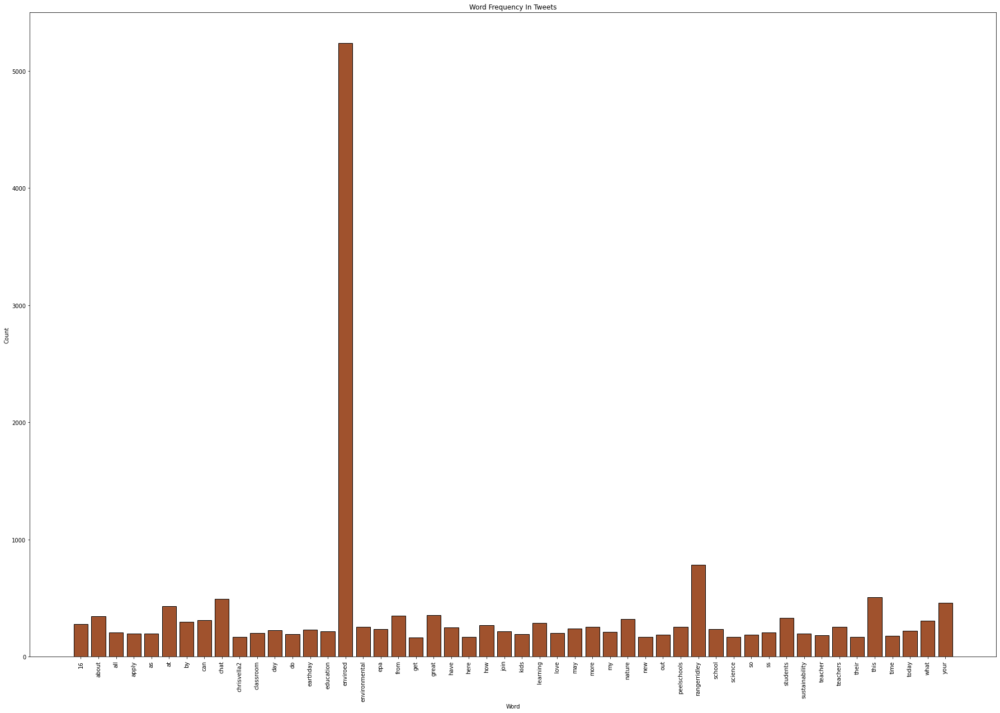

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
stop_list = ['a', 'an', 'the', 'it', 'is', 'i', 'and', 'or', 'am', 'are', 'of', 'on', 'to', 'but', 'be', 'that', 'with','https','for','in','co','rt','we','our','you']
count_vect = CountVectorizer(lowercase=True, stop_words=stop_list, max_features=500)
data_counts = count_vect.fit_transform(twitter_df['Tweet Text'])

x = count_vect.get_feature_names()
y = np.array(data_counts.todense()).sum(axis=0)

words_df = pd.DataFrame()
words_df['term'] = x
words_df['count'] = y

words_df = words_df[words_df['count'] > 160]
x = words_df['term']
y = words_df['count']

fig = plt.figure()
ax = fig.add_axes([0,0,4,4])
ax.bar(x,y,color='sienna',ec='k')
plt.xlabel('Word')
ax.tick_params(axis='x', labelrotation = 90)
plt.ylabel('Count')
plt.title('Word Frequency In Tweets')
plt.show()


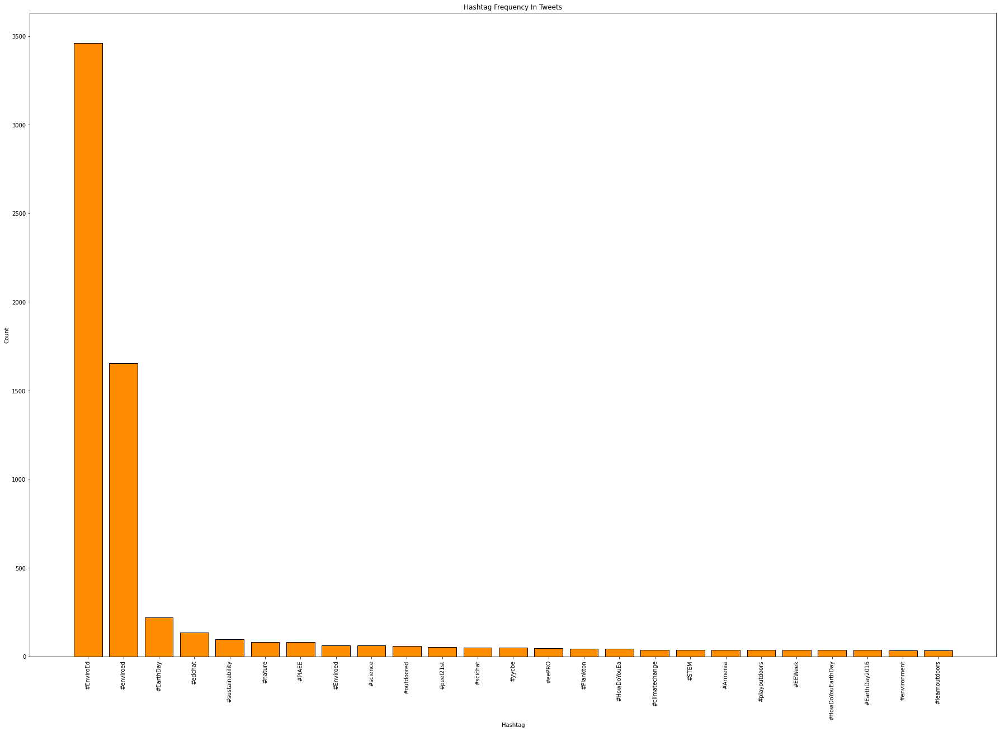

In [ ]:
import re
# (re) Sueper useful library I found, wish I found it sooner. https://www.datacamp.com/community/tutorials/python-regular-expression-tutorial
tweets = twitter_df['Tweet Text']

# Find hashtags
def find_hashtags(tweet):
    return re.findall('(#[A-Za-z]+[A-Za-z0-9-_]+)', tweet) 

twitter_df['hashtags'] = twitter_df['Tweet Text'].apply(find_hashtags)

# Format to sub-df
hashtags_list_df = twitter_df.loc[
                       twitter_df.hashtags.apply( lambda hashtags_list: hashtags_list !=[] ),['hashtags']]

# Clean up df
flattened_hashtags_df = pd.DataFrame([hashtag for hashtags_list in hashtags_list_df.hashtags for hashtag in hashtags_list], columns=['hashtag'])

# Count of appearances of each hashtag and sort
popular_hashtags = flattened_hashtags_df.groupby('hashtag').size().reset_index(name='counts').sort_values('counts', ascending=False).reset_index(drop=True)

popular_hashtags = popular_hashtags[:25]

# Graph
x = popular_hashtags.hashtag
y = popular_hashtags.counts

fig = plt.figure()
ax = fig.add_axes([0,0,4,4])
ax.bar(x,y,color='darkorange',ec='k')
plt.xlabel('Hashtag')
ax.tick_params(axis='x', labelrotation = 90)
plt.ylabel('Count')
plt.title('Hashtag Frequency In Tweets')
plt.show()


The most common word and hashtag is EnviroEd. This makes sense as this is the hashtag that allows the tweet to be added to the data base. Another word that is used a lot that is notable is is 'rangerridley' looking in the data, I can see that RangerRidley is a user whos tweets usually gets ReTweets. Another hashtag that appeared a lot was '#EarthDay' this makes sense since we saw earlier that April was the month where most of the tweets were tweeted.



#### i) Create a directed, weighted, social network graph where the nodes are the unique twitter users, the edges indicate if a user has mentioned another user in a tweet, and the weights are a count of how many times the user was mentioned. (Note that edges should be directed from the mentioning user to the mentioned user.)

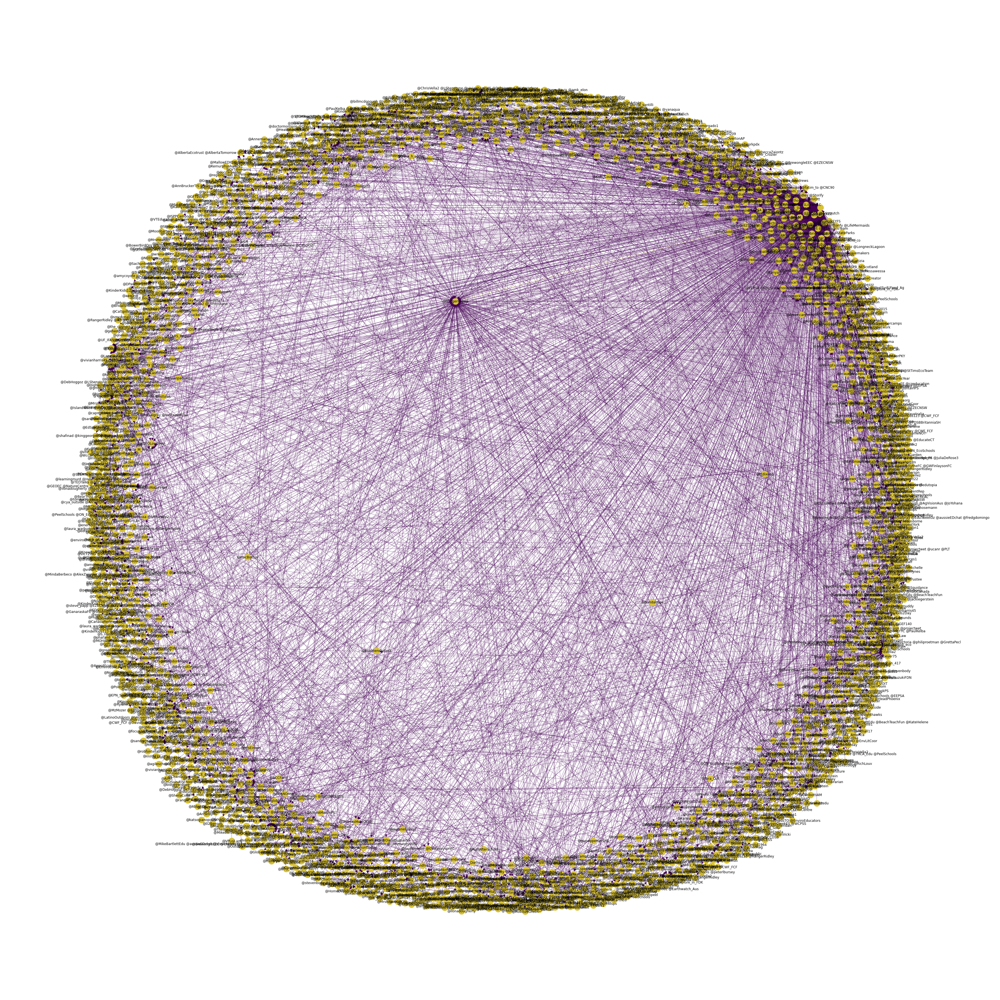

In [ ]:
# list to string (for later)
def listToString(s): 
    str1 = " " 
    return (str1.join(s))

# add 'mentioned' coloumn to df
def find_mentioned(tweet):
    return re.findall('(?<!RT\s)(@[A-Za-z]+[A-Za-z0-9-_]+)', tweet)

twitter_df['mentioned'] = twitter_df['Tweet Text'].apply(find_mentioned)
# print(twitter_df)

G = nx.DiGraph()

# Loop through each row in the dataframe
for idx, row in twitter_df.iterrows():
  # print('Processing row:', idx)
  from_node = row['Screen Name']
  s = row['mentioned']
  mentioned = (listToString(s))
  to_node = mentioned
  # print(' Screen Name', from_node, 'mentioned', to_node)

  # If there is already an edge, get its current weight
  # and re-add the edge with weight + 1
  if G.has_edge(from_node, to_node):
    w = G.get_edge_data(from_node, to_node)['weight']
    # print('  found existing edge, increasing weight to:', w+1)
    G.add_edge(from_node, to_node, weight=w+1)
  else:
    # Otherwise, add the edge with a weight of 1
    # print('  adding edge with weight: 1')
    G.add_edge(from_node, to_node, weight=1)

nodes = unique_df['Screen Name']

edge_weights = [G.edges[v, w]["weight"] for v, w in G.edges]

plt.figure(figsize=(50, 50))

# Calculate the best position for laying out the nodes graphically.
pos = nx.spring_layout(G, k=2) # k controls how far apart nodes are forced to be
nx.draw(G, pos=pos, with_labels=True,
        node_color='#D8C238', node_size=500,
        edge_color=edge_weights, width=0.5,
        edge_cmap=plt.cm.viridis, arrowsize=20)
plt.show()

#### ii) Show the graph info (nodes, edges, average in- and out-degree) and network density. You should have around 3,000 edges.

In [ ]:
nx.info(G)

'Name: \nType: DiGraph\nNumber of nodes: 2248\nNumber of edges: 2949\nAverage in degree:   1.3118\nAverage out degree:   1.3118'

#### iii) [Note that this step may be slow.] Calculate in-degree, out-degree, betweenness centrality, closeness centrality, and eigenvector centrality. Update each node in the graph with its values for these measures, similarly to how we did in lab labs. 

In [ ]:
in_degree_dict = dict(G.in_degree(G.nodes()))
nx.set_node_attributes(G, in_degree_dict, 'in_degree')

out_degree_dict = dict(G.out_degree(G.nodes()))
nx.set_node_attributes(G, out_degree_dict, 'out_degree')

betweenness_dict = nx.betweenness_centrality(G) 
nx.set_node_attributes(G, betweenness_dict, 'betweenness')

eigenvector_dict = nx.eigenvector_centrality(G) 
nx.set_node_attributes(G, eigenvector_dict, 'eigenvector')

#### iv) Print out the top 20 users (nodes) ranked by each of the following metrics: in-degree, out-degree, betweenness centrality, and eigenvector centrality.

In [ ]:
from operator import itemgetter

sorted_in_degree = sorted(in_degree_dict.items(), key=itemgetter(1), reverse=True)
sorted_out_degree = sorted(out_degree_dict.items(), key=itemgetter(1), reverse=True)
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)
sorted_eigenvector = sorted(eigenvector_dict.items(), key=itemgetter(1), reverse=True)

print("Top 10 nodes by in degree:")
for d in sorted_in_degree[:20]:
    print(d)

print("\nTop 10 nodes by out degree:")
for d in sorted_out_degree[:20]:
    print(d)

print("\nTop 10 nodes by betweenness centrality:")
for d in sorted_betweenness[:20]:
    print(d)

print("\nTop 10 nodes by eigenvector centrality:")
for d in sorted_eigenvector[:20]:
    print(d)

Top 10 nodes by in degree:
('', 1057)
('@RangerRidley', 58)
('@PeelSchools', 36)
('@JackSmytheFC', 32)
('@TED_ED', 28)
('@CWF_FCF', 27)
('@CKEnvCentre', 22)
('@PaulKelba', 22)
('@stevenbody', 16)
('@KQEDLowdown', 13)
('@ChrisVella2 @stevenbody', 13)
('@litterati', 12)
('@EZECNSW', 12)
('@vivianharris45', 12)
('@ChrisVella2 @LShenstone @vivianharris45 @DebHoggoz @KateHelene', 12)
('@PeelSchools @Adrian_T_Graham', 11)
('@ChrisVella2', 11)
('@UWCollegeOfEd', 11)
('@PeelSchools @ON_EcoSchools', 11)
('@RachelNotley @AlbertaEE @cgeducation', 10)

Top 10 nodes by out degree:
('@RangerRidley', 147)
('@ChrisVella2', 80)
('@Learn_OnTheFly', 48)
('@PaulKelba', 45)
('@EZECNSW', 45)
('@stevenbody', 40)
('@KinderKids123', 39)
('@DavidSpencerEdu', 30)
('@OCSBeco', 25)
('@KinderFynes', 21)
('@PDSB_eco', 21)
('@CWF_FCF', 20)
('@doctormorrison', 19)
('@NAAEEStaff', 19)
('@vivianharris45', 17)
('@BrewongleEEC', 16)
('@PeelSchools', 15)
('@IslandWood', 15)
('@DebHoggoz', 14)
('@GEOEC', 13)

Top 10 nodes b

#### v) In a markdown cell, discuss your observations of these 4 lists.

##### Aside from the blank values RangerRidley has the largest in degree, in part h when we found the most common words, RangerRidley had one of the highest counts. This makes senss why he has a high in degree becasue he seems like a popular user.
##### RangerRidley also has the highest out degree, meaning he tweets at different people frequently, he must be a very active user on twitter.
##### RangerRidley also has The highest betweeness centrality, this means he have considerable influence within a network by virtue of their control over information passing between others, since he is a good connector between two points. 
#### RangerRidley also had the greatest eigenvector centrality which means it connects to the most high connection nodes. Doing a quick google search I discovered RangerRidley is the moderator of the EnviroEd chat this makes sense becasue he is the complete center in all categories.

#### vi) Pick three Twitter users (nodes) for further exploration. Make a graph visualization for each of the user’s subgraphs.

In [ ]:
print(G.nodes['@RangerRidley'])
print(G.nodes['@ChrisVella2'])
print(G.nodes['@CWF_FCF'])

{'in_degree': 58, 'out_degree': 147, 'betweenness': 0.00815579883735971, 'eigenvector': 0.2886346504030984}
{'in_degree': 11, 'out_degree': 80, 'betweenness': 0.00123297488586401, 'eigenvector': 0.18874275374630312}
{'in_degree': 27, 'out_degree': 20, 'betweenness': 0.0021673262503571124, 'eigenvector': 0.06306096480608349}


In [ ]:
user_neighbors = []
L = G.edges()

for e in L:
  if ((e[0] == "@RangerRidley")|(e[0] == "@ChrisVella2")|(e[0] == "@CWF_FCF")):
    user_neighbors.append(e[1])
  if ((e[1] == "@RangerRidley")|(e[1] == "@ChrisVella2")|(e[1] == "@CWF_FCF")):
    user_neighbors.append(e[0])
user_neighbors.append("@RangerRidley")
user_neighbors.append("@ChrisVella2")
user_neighbors.append("@CWF_FCF")

len(set(user_neighbors))

264

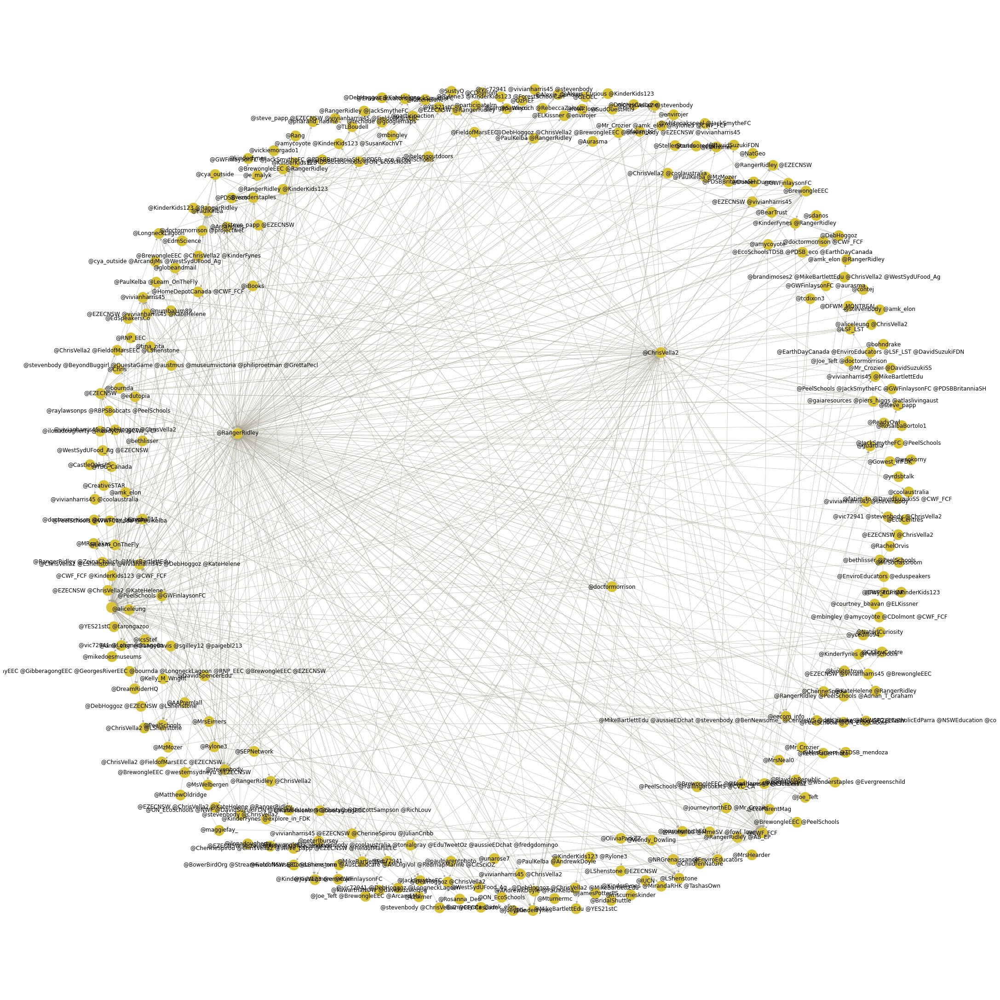

In [ ]:
G2 = G.subgraph(user_neighbors)

plt.figure(figsize=(30, 30))

# Calculate the best position for laying out the nodes graphically.
pos = nx.spring_layout(G2, k=4) # k controls how far apart nodes are forced to be
nx.draw(G2, pos=pos, with_labels=True,
        node_color='#D8C238', node_size=500,
        edge_color='#ABA896', width=0.5)
plt.show()

#### In a markdown cell, discuss three users you selected in terms of their graphs and assorted calculated metrics.

##### I picked three of the most central users, in order to see how interconnected they are to one another and it is proven to me that they have sonnections with the majority of the nodes on the main graph. 

### b) Pose an additional question or area of interest about this dataset, write code to answer it, show a visualization, and discuss your observations. Try to go beyond the first basic questions that may occur to you. For example, if you find yourself making a bar chart with only two bars, dig a little deeper.

In [ ]:
bar2 = sorted(twitter_df.groupby("App")['Followers'].sum().items(), key=itemgetter(1), reverse=True)[:10]
bar2

[('Twitter Web Client', 5951904),
 ('Hootsuite', 5500455),
 ('TweetDeck', 3930831),
 ('Twitter for iPhone', 2147021),
 ('Twitter for iPad', 1017899),
 ('Engagor', 765634),
 ('Twitter for Android', 750437),
 ('Buffer', 236810),
 ('RoundTeam', 204708),
 ('Storify', 191991)]

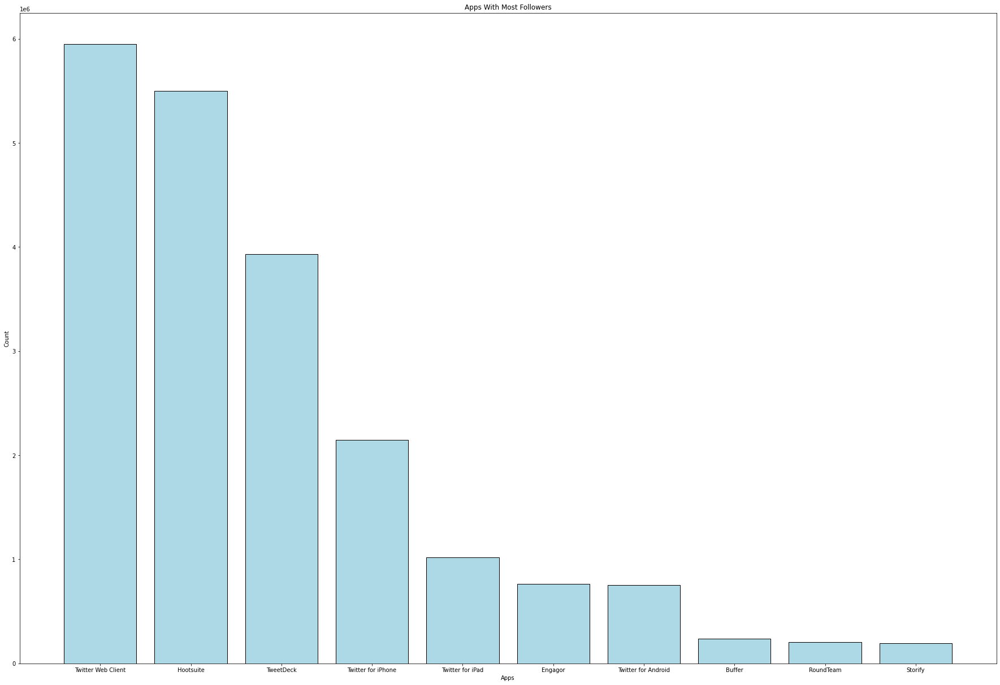

In [ ]:
x2= ['Twitter Web Client','Hootsuite','TweetDeck','Twitter for iPhone','Twitter for iPad','Engagor','Twitter for Android','Buffer','RoundTeam','Storify']
y2= [5951904,5500455,3930831,2147021,1017899,765634,750437,236810,204708,191991]

fig = plt.figure()
ax = fig.add_axes([0,0,4,4])
ax.bar(x2,y2,color='lightblue',ec='k')
plt.xlabel('Apps')
plt.ylabel('Count')
plt.title('Apps With Most Followers')
plt.show()

#### For my extra visualization I decided to look at the best apps for having the most followers, THis look how I expected as the 'Twitter For Web Client' is the most. What suprised me was Hoot suitue which I have never heard of.